---
---

## Determines

***Pen-Based Recognition of Handwritten Digits***
This digit database was created by collecting 250 samples from 44 writers. WACOM PL-100V pressure sensitive tablet used with an integrated LCD display and a cordless stylus. The input and display areas are located in the same place. Attached to the serial port of an Intel 486 based PC, it allows us to collect handwriting samples. The tablet sends $x$ and $y$ tablet coordinates and pressure level values of the pen at fixed time intervals (sampling rate) of 100 miliseconds. 

These writers are asked to write 250 digits in random order inside boxes of 500 by 500 tablet pixel resolution. Subject are monitored only during the first entry screens. Each screen contains five boxes with the digits to be written displayed above. Subjects are told to write only inside these boxes. If they make a mistake or are unhappy with their writing, they are instructed to clear the content of a box by using an on-screen button. The first ten digits are ignored because most writers are not familiar with this type of input devices, but subjects are not aware of this.

In this study, researchers use only ($x, y$) coordinate information. The stylus pressure level values are ignored. The raw data that we capture from the tablet consist of integer values between 0 and 500 (tablet input box resolution). The new coordinates are such that the coordinate which has the maximum range varies between 0 and 100. Usually $x$ stays in this range, since most characters are taller than they are wide.

Attribute information
In order to train and test our classifiers, we need to represent digits as constant length feature vectors. A commonly used technique leading to good results is resampling the ( x_t, y_t) points. Temporal resampling (points regularly spaced in time) or spatial resampling (points regularly spaced in arc length) can be used here. Raw point data are already regularly spaced in time but the distance between them is variable. 

- Data reference link : https://archive.ics.uci.edu/ml/datasets/Pen-Based+Recognition+of+Handwritten+Digits


---
---

#### 1. Exploratory Data Analysis (EDA)
- Import Libraries, Load Dataset, Exploring Data

    *i. Import Libraries*
    
    *ii. Load Dataset*
    
    *iii. Explore Data*

#### 2.  Data Cleaning
- Detect Missing Values and Outliers 

    *i. Missing Value Detection*
    
    *ii. Outlier Detection*

#### 3. Prediction (Multi-class Classification)
- Import libraries
- Data Preprocessing
- Implement SVM Classifer
- Implement Decision Tree Classifier
- Implement Random Forest Classifer
- Implement XGBoost Classifer
- Compare The Models



---
---

## 1. Exploratory Data Analysis

### Import Libraries, Load Dataset, Exploring Data

#### *i. Import Libraries*

In [330]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#### *ii. Load Dataset*

In [331]:
data_original= pd.read_csv("pendigits_txt.csv")
data= data_original.copy()
data

,input1,input2,input3,input4,input5,input6,input7,input8,input9,input10,input11,input12,input13,input14,input15,input16,class
0,47,100,27,81,57,37,26,0,0,23,56,53,100,90,40,98,8
1,0,89,27,100,42,75,29,45,15,15,37,0,69,2,100,6,2
2,0,57,31,68,72,90,100,100,76,75,50,51,28,25,16,0,1
3,0,100,7,92,5,68,19,45,86,34,100,45,74,23,67,0,4
4,0,67,49,83,100,100,81,80,60,60,40,40,33,20,47,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10987,36,100,24,70,0,38,49,33,95,47,87,55,96,21,100,0,4
10988,16,75,41,100,52,64,32,27,0,0,21,9,62,2,100,14,2
10989,56,100,27,79,0,39,12,0,66,15,100,51,93,93,38,93,0
10990,19,100,0,61,3,23,48,0,97,27,100,66,62,97,10,81,0


#### *iii. Explore Data*
- Focus on numerical
- Focus on Target Variable (class)
 - Detect relationships and correlations between independent variables and target variable.
 - It may be nice to visualize the class frequencies of the target variable.
- Detect relationships and correlations between independent variables. (You can prefer to keep only one of the highly correlated continuous variables.)
- Consider dropping features that contain little data or that you think will not contribute to the model.

In [332]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10992 entries, 0 to 10991
Data columns (total 17 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   input1   10992 non-null  int64
 1   input2   10992 non-null  int64
 2   input3   10992 non-null  int64
 3   input4   10992 non-null  int64
 4   input5   10992 non-null  int64
 5   input6   10992 non-null  int64
 6   input7   10992 non-null  int64
 7   input8   10992 non-null  int64
 8   input9   10992 non-null  int64
 9   input10  10992 non-null  int64
 10  input11  10992 non-null  int64
 11  input12  10992 non-null  int64
 12  input13  10992 non-null  int64
 13  input14  10992 non-null  int64
 14  input15  10992 non-null  int64
 15  input16  10992 non-null  int64
 16  class    10992 non-null  int64
dtypes: int64(17)
memory usage: 1.4 MB


In [333]:
data.duplicated().sum()

0

In [334]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
input1,10992.0,38.814320,34.257783,0.0,6.0,32.0,65.0,100.0
input2,10992.0,85.120269,16.218571,0.0,76.0,89.0,100.0,100.0
input3,10992.0,40.605622,26.342984,0.0,20.0,40.0,58.0,100.0
input4,10992.0,83.774199,19.163646,0.0,72.0,91.0,100.0,100.0
input5,10992.0,49.770378,34.100515,0.0,18.0,53.0,78.0,100.0
input6,10992.0,65.573144,26.996688,0.0,49.0,71.0,86.0,100.0
input7,10992.0,51.220251,30.576881,0.0,28.0,53.5,74.0,100.0
input8,10992.0,44.498999,29.906104,0.0,23.0,43.0,64.0,100.0
input9,10992.0,56.868541,34.135530,0.0,29.0,60.0,89.0,100.0
input10,10992.0,33.695961,27.251548,0.0,7.0,33.0,54.0,100.0


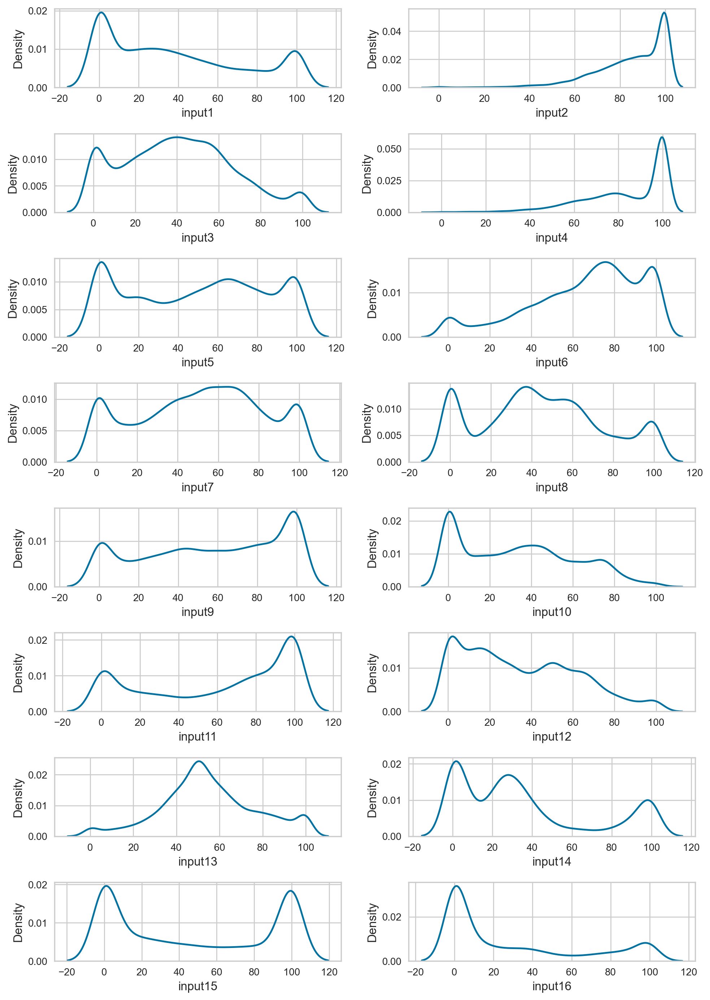

In [335]:
fig = plt.figure(figsize=(10,14), dpi=200)
for i, col in enumerate(data.columns[:-1]):
        plt.subplot(8,2,i+1)
        sns.kdeplot(data[col])
plt.tight_layout();

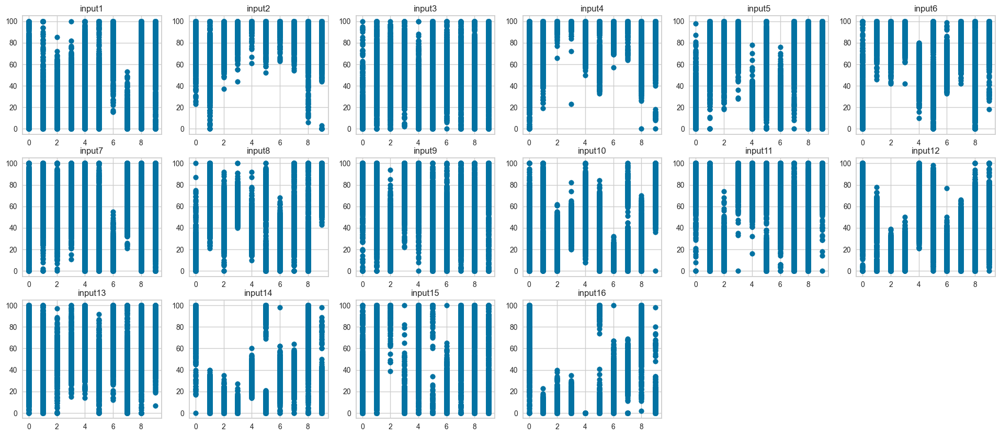

In [336]:
data2= data.sample(5)
plt.figure(figsize=(24,10))
index=0
for i in data2.columns[:-1]:
    index+=1
    plt.subplot(3,6,index)
    plt.scatter( x=data['class'], y=data[f"{i}"])
    #sns.scatterplot( x=data2['class'], y=data2[f"{i}"], hue=data2.index)
    plt.title(i)

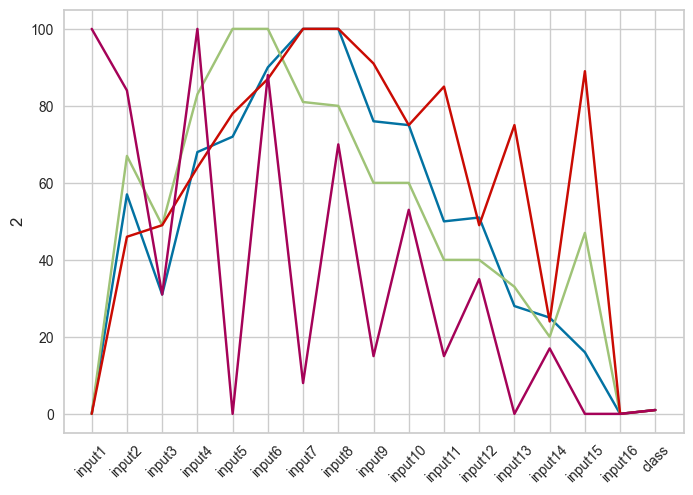

In [337]:
# Lineplot for class 1 (digit 1)
sns.lineplot(x=data.columns, y=data.loc[2])
sns.lineplot(x=data.columns, y=data.loc[4])

sns.lineplot(x=data.columns, y=data.loc[21])
sns.lineplot(x=data.columns, y=data.loc[29])
plt.xticks(rotation=45);

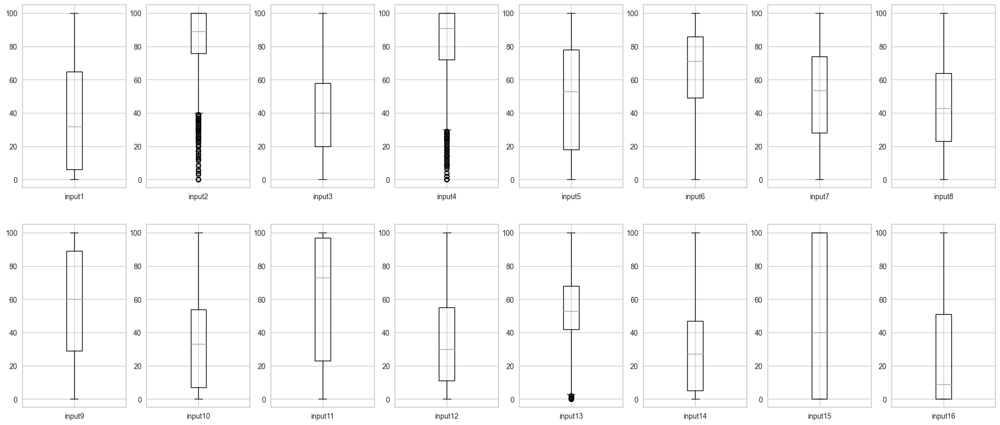

In [338]:
plt.figure(figsize=(24,10))
index=0
for i in data.columns[:-1]:
    index+=1
    plt.subplot(2,8,index)
    data.boxplot(column=i)

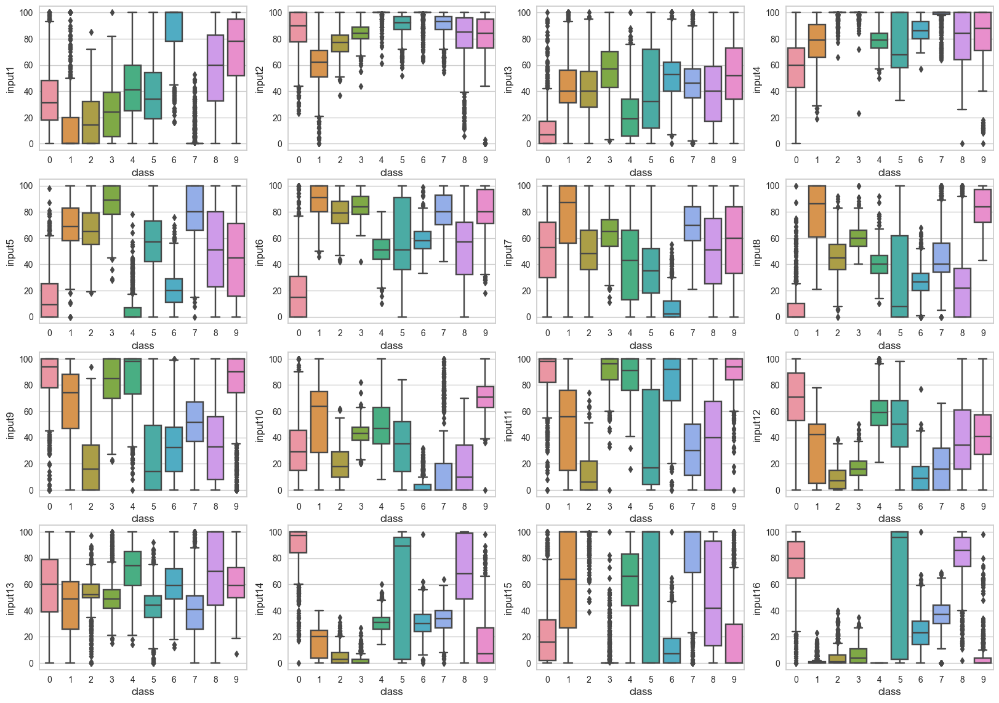

In [339]:
plt.figure(figsize=(20,14))
index=0
for i in data.columns[:-1]:
    index+=1
    plt.subplot(4,4,index)
    sns.boxplot(data=data,x="class", y=i)

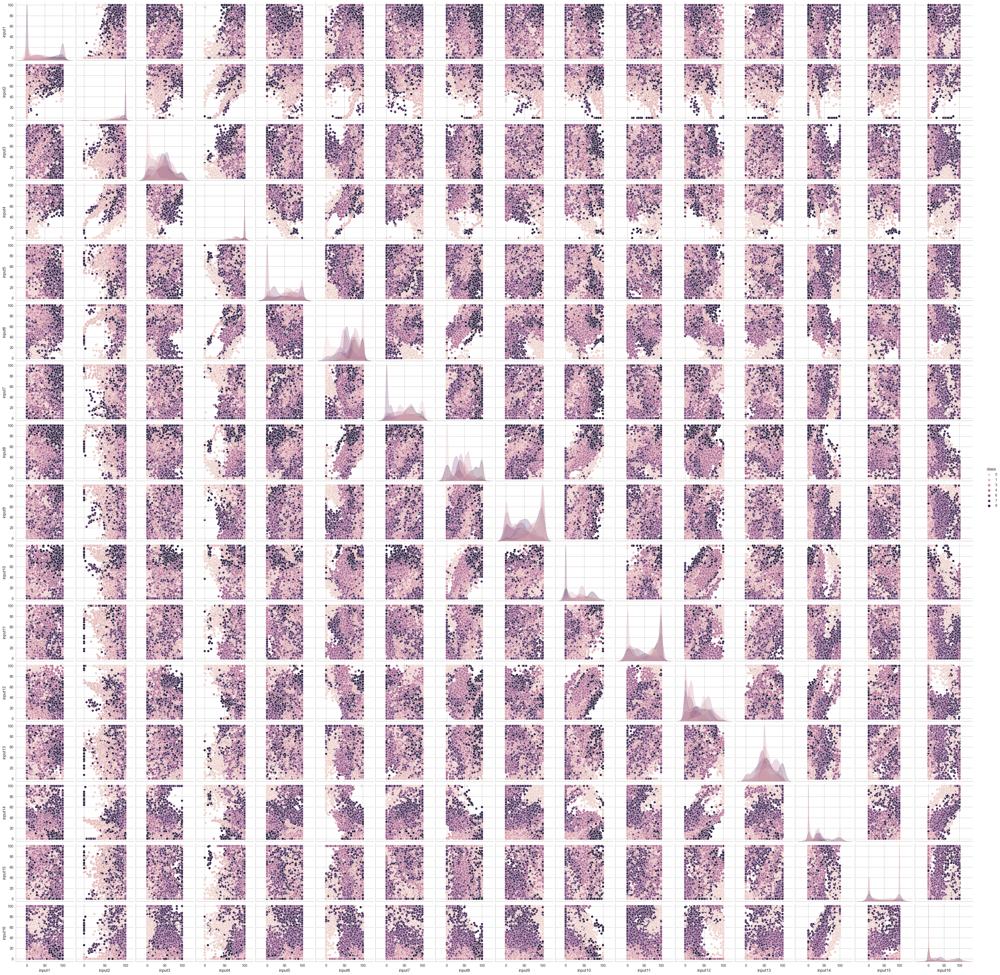

In [340]:
sns.pairplot(data=data, hue="class")

In [341]:
data["class"].value_counts(normalize=True).sort_index()

0    0.103985
1    0.103985
2    0.104076
3    0.095979
4    0.104076
5    0.095979
6    0.096070
7    0.103894
8    0.095979
9    0.095979
Name: class, dtype: float64

***
***

## 2.  Data Cleaning

### Detect Missing Values and Outliers

#### *i. Missing Value Detection*

In [342]:
data.isnull().sum().any()

False

#### *ii. Outlier Detection*

The columns which have continuous value should be examined in terms of [outliers](https://datascience.foundation/sciencewhitepaper/knowing-all-about-outliers-in-machine-learning) (Watch out for columns that look like continuous but not continuous!). Some algorithms are [sensitive to outliers](https://arsrinevetha.medium.com/ml-algorithms-sensitivity-towards-outliers-f3862a13c94d), but some algorithms can tolerate them. You can decide to outlier detection according to the algorithm you will use.
- You can check the outliers shape of continous features with respect to the target ("class") classes.
- You can check how many outliers are there of each continuous variables.
- The columns which have continuous value should be examined in terms of outliers.
- You can define a function to detect outliers in accordance with the ``zscore`` or ``IQR``.

In [343]:
def detect_outliers(df, col_name,tukey=1.5):
    ''' 
    this function detects outliers based on 1.5 time IQR and
    returns the number of lower and uper limit and number of outliers respectively
    '''
    first_quartile = np.percentile(np.array(df[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(df[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile
                      
    upper_limit = third_quartile+(tukey*IQR)
    lower_limit = first_quartile-(tukey*IQR)
    outlier_count = 0
                      
    for value in df[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [344]:
threshold = 1.5
out_cols = []
for col in data.columns:
    print(
        f"{col}\nlower:{detect_outliers(data, col,threshold)[0]} \nupper:{detect_outliers(data, col,threshold)[1]}\
        \noutlier:{detect_outliers(data, col,threshold)[2]}\n*-*-*-*-*-*-*"
    )
    if detect_outliers(data, col,threshold)[2] > 0 :
        out_cols.append(col)
print(out_cols)   

input1
lower:-82.5 
upper:153.5        
outlier:0
*-*-*-*-*-*-*
input2
lower:40.0 
upper:136.0        
outlier:196
*-*-*-*-*-*-*
input3
lower:-37.0 
upper:115.0        
outlier:0
*-*-*-*-*-*-*
input4
lower:30.0 
upper:142.0        
outlier:153
*-*-*-*-*-*-*
input5
lower:-72.0 
upper:168.0        
outlier:0
*-*-*-*-*-*-*
input6
lower:-6.5 
upper:141.5        
outlier:0
*-*-*-*-*-*-*
input7
lower:-41.0 
upper:143.0        
outlier:0
*-*-*-*-*-*-*
input8
lower:-38.5 
upper:125.5        
outlier:0
*-*-*-*-*-*-*
input9
lower:-61.0 
upper:179.0        
outlier:0
*-*-*-*-*-*-*
input10
lower:-63.5 
upper:124.5        
outlier:0
*-*-*-*-*-*-*
input11
lower:-88.0 
upper:208.0        
outlier:0
*-*-*-*-*-*-*
input12
lower:-55.0 
upper:121.0        
outlier:0
*-*-*-*-*-*-*
input13
lower:3.0 
upper:107.0        
outlier:208
*-*-*-*-*-*-*
input14
lower:-58.0 
upper:110.0        
outlier:0
*-*-*-*-*-*-*
input15
lower:-150.0 
upper:250.0        
outlier:0
*-*-*-*-*-*-*
input16
lower:-76.5 
upper:127.5

### Deal with Outliers


### I will drop all rows which contain outliers in  columns above

#### *ii. Drop Outliers* 
- Warning : Observe the scores before and after dropping the outliers 

In [345]:
#to drop outliers over 1,5 iqr
for col in out_cols:
    data_cleaned = data[(data[col] > detect_outliers(data, col)[0])
             & (data[col] < detect_outliers(data, col)[1])]

### Original and cleaned data will be processed to compare the results, so kept both.

In [346]:
data.shape

(10992, 17)

In [347]:
data_cleaned.shape

(10765, 17)

In [348]:
data_cleaned = data_cleaned.reset_index(drop=True)

In [349]:
data_cleaned["class"].value_counts(normalize=True).sort_index()

0    0.105248
1    0.097538
2    0.105434
3    0.098003
4    0.106270
5    0.096795
6    0.098096
7    0.099118
8    0.095495
9    0.098003
Name: class, dtype: float64

In [350]:
# cleaned data stored as csv for next steps
data_cleaned.to_csv("handdigit_EDA.csv", index = False)

***
***

## 3. Prediction (Multi-class Classification)

In this section, you have two main tasks that apply to each algorithm:
1. Model Building and Prediction

 - SVM (Use ``SVC`` model from``sklearn.svm`` module)
 - Decision Tree (Use ``DecisionTreeClassifier`` model from ``sklearn.tree`` module)
 - Random Forest (Use ``RandomForestClassifier`` model from ``sklearn.ensemble`` module) 
 - XGBoost (Use ``XGBClassifier`` model from``xgboost`` module)

2. Visualizing the Result

- Use [yellowbrick](https://www.scikit-yb.org/en/latest/), [seaborn](https://seaborn.pydata.org/tutorial/regression.html) or [matplotlib](https://matplotlib.org/) modules to visualize the model results.

- Show three plots for the results:
 - Class Prediction Error Bar Plot
 - Confusion Matrix
 - Classification Report
 - ROC/AUC Curve

### Import Libraries

In [351]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score,f1_score, confusion_matrix, classification_report,ConfusionMatrixDisplay, RocCurveDisplay, PrecisionRecallDisplay
from yellowbrick.classifier import ClassPredictionError, ROCAUC

### Data Preprocessing

- Drop target variable
- Train-Test Split

*Note: You can use the train and test data generated here for all algorithms.*

In [352]:
X=data.drop("class", axis=1)
y= data["class"]

In [353]:
X_train, X_test, y_train, y_test= train_test_split (X,y,test_size=0.25, shuffle=False)

### Implement Support Vector Machine
- Import the modul 
- Fit the model 
- Predict the test set
- Visualize and evaluate the result (use yellowbrick module)


#### Vanilla SVC

In [354]:
pipe_model=Pipeline([("scaler", MinMaxScaler()),("svc", SVC () )])
pipe_model.fit(X_train, y_train)

Pipeline(steps=[('scaler', MinMaxScaler()), ('svc', SVC())])

In [355]:

pipe_model.score(X_test, y_test)

0.9894468704512372

In [356]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred, digits= 3))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred, digits= 3))

In [357]:
eval_metric(pipe_model, X_train, y_train, X_test, y_test)

Test_Set
[[270   0   0   0   0   0   0   0   2   0]
 [  0 283   7   0   1   0   0   1   0   0]
 [  0   1 293   0   0   0   0   0   0   0]
 [  0   0   0 277   0   0   0   0   0   1]
 [  0   0   0   0 288   2   0   0   0   0]
 [  0   0   0   3   0 263   0   0   0   1]
 [  0   0   0   0   0   0 264   0   0   0]
 [  0   2   2   0   0   0   0 265   0   0]
 [  0   0   0   0   0   1   0   0 255   0]
 [  0   1   0   0   0   0   0   3   1 261]]
              precision    recall  f1-score   support

           0      1.000     0.993     0.996       272
           1      0.986     0.969     0.978       292
           2      0.970     0.997     0.983       294
           3      0.989     0.996     0.993       278
           4      0.997     0.993     0.995       290
           5      0.989     0.985     0.987       267
           6      1.000     1.000     1.000       264
           7      0.985     0.985     0.985       269
           8      0.988     0.996     0.992       256
           9      0

In [358]:
scores = cross_validate(pipe_model, X_train, y_train, scoring = ['accuracy', 'precision_weighted','recall_weighted','f1_weighted'], cv = 10,
                       return_train_score=True )

df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy               0.994662
train_accuracy              0.995808
test_precision_weighted     0.994735
train_precision_weighted    0.995812
test_recall_weighted        0.994662
train_recall_weighted       0.995808
test_f1_weighted            0.994663
train_f1_weighted           0.995807
dtype: float64

#### SVC GridsearchCV

In [359]:
param_grid = {'SVC__C': np.linspace(1,1.3, 10),
              'SVC__gamma': ["scale","auto"],
              'SVC__kernel': ['rbf', 'linear']}
operations = [("scaler", MinMaxScaler()), ("SVC", SVC())]
pipe_model = Pipeline(steps=operations)

svm_model_grid = GridSearchCV(pipe_model, 
                              param_grid, 
                              scoring="accuracy", 
                              cv=5, 
                              return_train_score=True, 
                              verbose=2, 
                              n_jobs=-1, 
                              refit=True)

In [360]:
svm_model_grid.fit(X_train,y_train)

Fitting 5 folds for each of 40 candidates, totalling 200 fits
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.2s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.2s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.2s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.2s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.2s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.3s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.3s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.4s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.3s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.4s
[CV] END ....SVC__C=1.0, SVC__gamma=auto, SVC__kernel=linear; total time=   0.1s
[CV] END ....SVC__C=1.0, SVC__gamma=auto, SVC__

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', MinMaxScaler()),
                                       ('SVC', SVC())]),
             n_jobs=-1,
             param_grid={'SVC__C': array([1.        , 1.03333333, 1.06666667, 1.1       , 1.13333333,
       1.16666667, 1.2       , 1.23333333, 1.26666667, 1.3       ]),
                         'SVC__gamma': ['scale', 'auto'],
                         'SVC__kernel': ['rbf', 'linear']},
             return_train_score=True, scoring='accuracy', verbose=2)

In [361]:
svm_model_grid.best_score_

0.9947836140761981

In [362]:
svm_model_grid.best_params_

{'SVC__C': 1.1666666666666667, 'SVC__gamma': 'scale', 'SVC__kernel': 'rbf'}

In [363]:
eval_metric(svm_model_grid, X_train, y_train, X_test, y_test)

Test_Set
[[271   0   0   0   0   0   0   0   1   0]
 [  0 283   7   0   1   0   0   1   0   0]
 [  0   1 293   0   0   0   0   0   0   0]
 [  0   0   0 277   0   0   0   0   0   1]
 [  0   0   0   0 288   2   0   0   0   0]
 [  0   0   0   3   0 263   0   0   0   1]
 [  0   0   0   0   0   0 264   0   0   0]
 [  0   2   2   0   0   0   0 265   0   0]
 [  0   0   0   0   0   1   0   0 255   0]
 [  0   1   0   0   0   0   0   3   1 261]]
              precision    recall  f1-score   support

           0      1.000     0.996     0.998       272
           1      0.986     0.969     0.978       292
           2      0.970     0.997     0.983       294
           3      0.989     0.996     0.993       278
           4      0.997     0.993     0.995       290
           5      0.989     0.985     0.987       267
           6      1.000     1.000     1.000       264
           7      0.985     0.985     0.985       269
           8      0.992     0.996     0.994       256
           9      0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


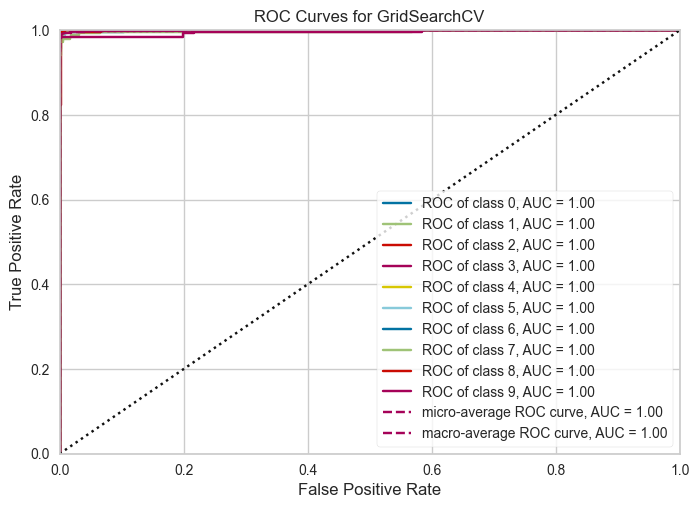

In [364]:
visualizer = ROCAUC(svm_model_grid, classes=[str(i) for i in range(10)])

visualizer.fit(X_train, y_train)        # Fit the training data to the visualizer
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show();   

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


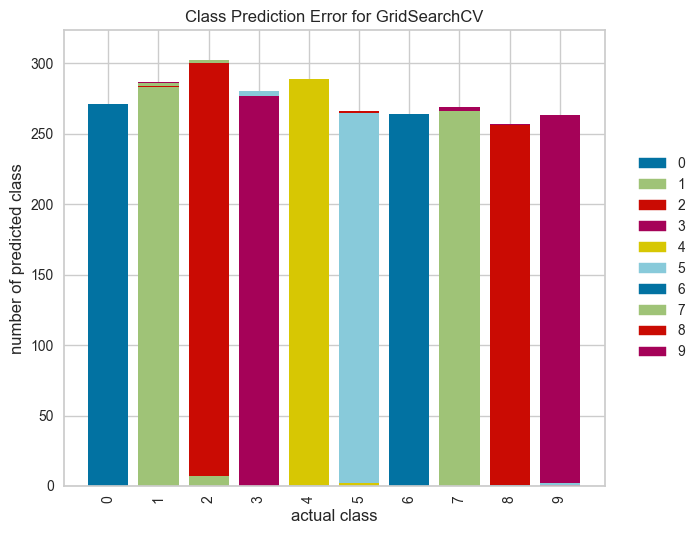

<Axes: title={'center': 'Class Prediction Error for GridSearchCV'}, xlabel='actual class', ylabel='number of predicted class'>

In [365]:
visualizer = ClassPredictionError(svm_model_grid)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.show()


### SVM with Dropped Outliers

In [366]:
X=data_cleaned.drop("class", axis=1)
y= data_cleaned["class"]

In [367]:
X_train, X_test, y_train, y_test= train_test_split (X,y,test_size=0.25, shuffle=False)

In [368]:
pipe_model=Pipeline([("scaler", MinMaxScaler()),("svc", SVC () )])
pipe_model.fit(X_train, y_train)

Pipeline(steps=[('scaler', MinMaxScaler()), ('svc', SVC())])

In [369]:

pipe_model.score(X_test, y_test)

0.9899702823179792

In [370]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred, digits= 3))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred, digits= 3))

In [371]:
eval_metric(pipe_model, X_train, y_train, X_test, y_test)

Test_Set
[[269   0   0   0   0   0   0   0   2   0]
 [  0 257   7   0   1   0   0   1   0   0]
 [  0   1 291   0   0   0   0   0   0   0]
 [  0   0   0 274   0   0   0   0   0   1]
 [  0   0   0   0 286   2   0   0   0   0]
 [  0   0   0   3   0 260   0   0   0   1]
 [  0   0   0   0   0   0 260   0   0   0]
 [  0   3   0   0   0   0   0 257   0   0]
 [  0   0   0   0   0   0   0   0 251   0]
 [  0   1   0   0   0   0   0   3   1 260]]
              precision    recall  f1-score   support

           0      1.000     0.993     0.996       271
           1      0.981     0.966     0.973       266
           2      0.977     0.997     0.986       292
           3      0.989     0.996     0.993       275
           4      0.997     0.993     0.995       288
           5      0.992     0.985     0.989       264
           6      1.000     1.000     1.000       260
           7      0.985     0.988     0.987       260
           8      0.988     1.000     0.994       251
           9      0

In [372]:
# SVC GridsearchCV
param_grid = {'SVC__C': np.linspace(1,1.3, 10),
              'SVC__gamma': ["scale","auto"],
              'SVC__kernel': ['rbf', 'linear']}
operations = [("scaler", MinMaxScaler()), ("SVC", SVC())]
pipe_model = Pipeline(steps=operations)

svm_model_grid = GridSearchCV(pipe_model, 
                              param_grid, 
                              scoring="accuracy", 
                              cv=5, 
                              return_train_score=True, 
                              verbose=2, 
                              n_jobs=-1, 
                              refit=True)

In [373]:
svm_model_grid.fit(X_train,y_train)

Fitting 5 folds for each of 40 candidates, totalling 200 fits
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.1s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.1s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.1s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.1s
[CV] END ...SVC__C=1.0, SVC__gamma=scale, SVC__kernel=linear; total time=   0.1s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.2s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.2s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.2s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.2s
[CV] END ......SVC__C=1.0, SVC__gamma=scale, SVC__kernel=rbf; total time=   0.2s
[CV] END ....SVC__C=1.0, SVC__gamma=auto, SVC__kernel=linear; total time=   0.1s
[CV] END ....SVC__C=1.0, SVC__gamma=auto, SVC__

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', MinMaxScaler()),
                                       ('SVC', SVC())]),
             n_jobs=-1,
             param_grid={'SVC__C': array([1.        , 1.03333333, 1.06666667, 1.1       , 1.13333333,
       1.16666667, 1.2       , 1.23333333, 1.26666667, 1.3       ]),
                         'SVC__gamma': ['scale', 'auto'],
                         'SVC__kernel': ['rbf', 'linear']},
             return_train_score=True, scoring='accuracy', verbose=2)

In [374]:
svm_model_grid.best_score_

0.994549242119074

In [375]:
svm_model_grid.best_params_

{'SVC__C': 1.2, 'SVC__gamma': 'scale', 'SVC__kernel': 'rbf'}

In [376]:
eval_metric(svm_model_grid, X_train, y_train, X_test, y_test)

Test_Set
[[270   0   0   0   0   0   0   0   1   0]
 [  0 258   6   0   1   0   0   1   0   0]
 [  0   1 291   0   0   0   0   0   0   0]
 [  0   0   0 274   0   0   0   0   0   1]
 [  0   0   0   0 287   1   0   0   0   0]
 [  0   0   0   3   0 260   0   0   0   1]
 [  0   0   0   0   0   0 260   0   0   0]
 [  0   1   0   0   0   0   0 259   0   0]
 [  0   0   0   0   0   0   0   0 251   0]
 [  0   1   0   0   0   0   0   3   1 260]]
              precision    recall  f1-score   support

           0      1.000     0.996     0.998       271
           1      0.989     0.970     0.979       266
           2      0.980     0.997     0.988       292
           3      0.989     0.996     0.993       275
           4      0.997     0.997     0.997       288
           5      0.996     0.985     0.990       264
           6      1.000     1.000     1.000       260
           7      0.985     0.996     0.990       260
           8      0.992     1.000     0.996       251
           9      0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


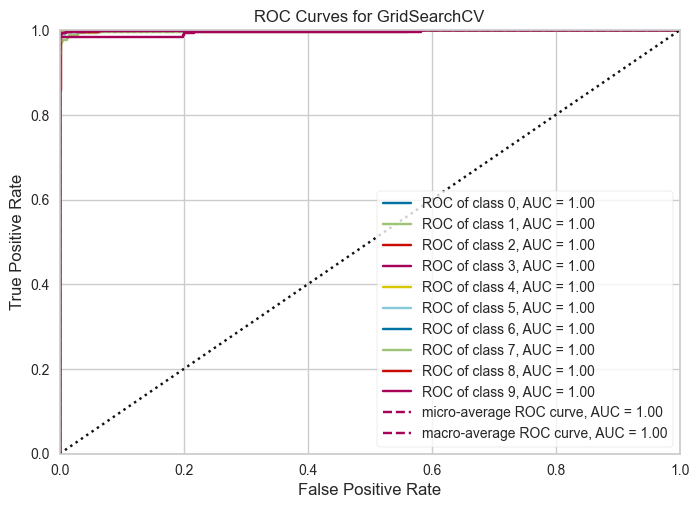

In [377]:
visualizer = ROCAUC(svm_model_grid, classes=[str(i) for i in range(10)])

visualizer.fit(X_train, y_train)        # Fit the training data to the visualizer
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show();   

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


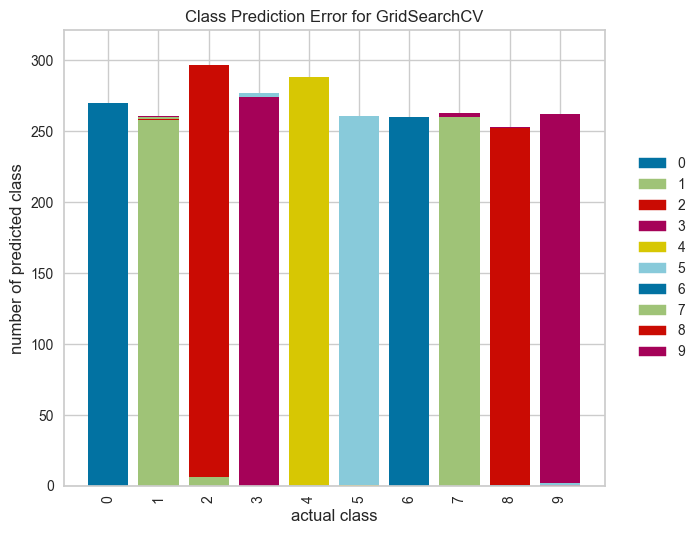

<Axes: title={'center': 'Class Prediction Error for GridSearchCV'}, xlabel='actual class', ylabel='number of predicted class'>

In [378]:
visualizer = ClassPredictionError(svm_model_grid)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.show()


#### Comparison between cleaned and uncleaned data results
* Cleaned data (with dropped outliers) is slightly better than uncleaned data.
* Outlier cleaning seemed to help clean the noise in the data.
* The current results are good enough. But for better results, further cleaning can be done considering the class outliers individually.